# Infer Posterior Distribution of Population Parameters across Lung Cancer Groups

Data:

1. Low erlotinib dose group
2. Medium erlotinib dose group
3. Hogh erlotinib dose group

In [1]:
import os

import arviz as az
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pints
import xarray as xr

import erlotinib as erlo

## Show data

In [2]:
# Get data
data_l = erlo.DataLibrary().lung_cancer_low_erlotinib_dose_group()

# Create scatter plots of data
fig = erlo.plots.PKTimeSeriesPlot()
fig.add_data(data_l, biomarker='Plasma concentration')
fig.set_axis_labels(
    time_label=r'$\text{Time in day}$', 
    dose_label=r'$\text{Dose amount in mg}$',
    biom_label=r'$\text{Plasma conc. in ng/mL}$')
fig.show()

fig = erlo.plots.PDTimeSeriesPlot()
fig.add_data(data_l, biomarker='Tumour volume')
fig.set_axis_labels(xlabel=r'$\text{Time in day}$', ylabel=r'$\text{Tumour volume in cm}^3$')
fig.show()

In [3]:
# Get data
data_m = erlo.DataLibrary().lung_cancer_medium_erlotinib_dose_group()

# Create scatter plots of data
fig = erlo.plots.PKTimeSeriesPlot()
fig.add_data(data_m, biomarker='Plasma concentration')
fig.set_axis_labels(
    time_label=r'$\text{Time in day}$', 
    dose_label=r'$\text{Dose amount in mg}$',
    biom_label=r'$\text{Plasma conc. in ng/mL}$')
fig.show()

fig = erlo.plots.PDTimeSeriesPlot()
fig.add_data(data_m, biomarker='Tumour volume')
fig.set_axis_labels(xlabel=r'$\text{Time in day}$', ylabel=r'$\text{Tumour volume in cm}^3$')
fig.show()

In [4]:
# Get data
data_h = erlo.DataLibrary().lung_cancer_high_erlotinib_dose_group()

# Create scatter plots of data
fig = erlo.plots.PKTimeSeriesPlot()
fig.add_data(data_h, biomarker='Plasma concentration')
fig.set_axis_labels(
    time_label=r'$\text{Time in day}$', 
    dose_label=r'$\text{Dose amount in mg}$',
    biom_label=r'$\text{Plasma conc. in ng/mL}$')
fig.show()

fig = erlo.plots.PDTimeSeriesPlot()
fig.add_data(data_h, biomarker='Tumour volume')
fig.set_axis_labels(xlabel=r'$\text{Time in day}$', ylabel=r'$\text{Tumour volume in cm}^3$')
fig.show()

## Build model

In [5]:
# Define mechanistic model
path = erlo.ModelLibrary().erlotinib_tumour_growth_inhibition_model()
mechanistic_model = erlo.PharmacokineticModel(path)
mechanistic_model.set_administration(compartment='central', direct=False)
mechanistic_model.set_parameter_names(names={
    'central.drug_amount': 'Initial plasma drug amount in mg',
    'dose.drug_amount': 'Initial dose comp. drug amount in mg',
    'central.size': 'Volume of distribution in L',
    'dose.absorption_rate': 'Absorption rate in 1/d',
    'myokit.elimination_rate': 'Elimination rate in 1/d',
    'myokit.tumour_volume': 'Initial tumour volume in cm^3',
    'myokit.critical_volume': 'Critical volume in cm^3',
    'myokit.kappa': 'Potency in L/mg/day',
    'myokit.lambda': 'Exponential growth rate in 1/day'})
mechanistic_model.set_outputs([
    'central.drug_concentration',
    'myokit.tumour_volume'])
mechanistic_model.set_output_names({
    'central.drug_concentration': 'Plasma conc. in ng/mL',
    'myokit.tumour_volume': 'Tumour volume in cm^3'})

# Define error model
error_models = [
    erlo.ConstantAndMultiplicativeGaussianErrorModel(),  # Plasma conc.
    erlo.ConstantAndMultiplicativeGaussianErrorModel()]  # Tumour volume

# Define population model
population_models = [
    erlo.TruncatedGaussianModel(),  # Initial tumour volume
    erlo.PooledModel(),             # Volume of distribution
    erlo.TruncatedGaussianModel(),  # Critical volume
    erlo.PooledModel(),             # Elimination rate
    erlo.TruncatedGaussianModel(),  # Potency
    erlo.TruncatedGaussianModel(),  # Growth rate
    erlo.PooledModel(),             # Plasma conc. Sigma rel.
    erlo.PooledModel()]             # Tumour volume Sigma rel.

# Compose model and not identified parameters
problem = erlo.ProblemModellingController(mechanistic_model, error_models)
problem.fix_parameters({
    'Initial plasma drug amount in mg': 0,
    'Initial dose comp. drug amount in mg': 0,
    'Absorption rate in 1/d': 55,  # Data not rich enough (value from Eigenmann et. al.)
    'Plasma conc. in ng/mL Sigma base': 0.001,  # Regularises MultiplicativeError
    'Tumour volume in cm^3 Sigma base': 0.001}) # Regularises MultiplicativeError
problem.set_population_model(population_models)

## Prior Predictive Check

In [6]:
# Define prior distribution
log_priors = [
    pints.TruncatedGaussianLogPrior(mean=0.1, sd=1, a=0, b=np.inf),      # Mu Initial tumour volume
    pints.TruncatedGaussianLogPrior(mean=1, sd=1, a=0, b=np.inf),        # Sigma Initial tumour volume
    pints.TruncatedGaussianLogPrior(mean=0.1, sd=0.05, a=0, b=np.inf),   # Volume of distribution
    pints.TruncatedGaussianLogPrior(mean=1, sd=1, a=0, b=np.inf),        # Mu Critical tumour volume
    pints.TruncatedGaussianLogPrior(mean=1, sd=1, a=0, b=np.inf),        # Sigma Critical tumour volume
    pints.TruncatedGaussianLogPrior(mean=10, sd=5, a=0, b=np.inf),       # Pooled Elimination rate
    pints.TruncatedGaussianLogPrior(mean=0.1, sd=0.1, a=0, b=np.inf),    # Mu Potency
    pints.TruncatedGaussianLogPrior(mean=0.1, sd=0.1, a=0, b=np.inf),    # Sigma Potency
    pints.TruncatedGaussianLogPrior(mean=0.1, sd=1, a=0, b=np.inf),      # Mu Growth rate
    pints.TruncatedGaussianLogPrior(mean=1, sd=1, a=0, b=np.inf),        # Sigma Growth rate
    pints.TruncatedGaussianLogPrior(mean=0.1, sd=0.1, a=0, b=np.inf),    # Pooled Plasma conc. Sigma rel.
    pints.TruncatedGaussianLogPrior(mean=0.1, sd=0.1, a=0, b=np.inf)]    # Pooled Tumour volume Sigma rel.
log_prior = pints.ComposedLogPrior(*log_priors)

# Compose prior predictive model
predictive_model = problem.get_predictive_model()
prior_predictive_model = erlo.PriorPredictiveModel(
    predictive_model, log_prior)
prior_predictive_model.set_dosing_regimen(dose=0.7, start=3, period=1, num=14)

# Sample from prior predictive model
times = np.linspace(0, 30, num=200)
n_samples = 100
samples = prior_predictive_model.sample(times, n_samples)

# Illustrate prior predictive model
fig = erlo.plots.PDPredictivePlot()
fig.add_prediction(data=samples, biomarker='Plasma conc. in ng/mL', bulk_probs=[0.3, 0.6, 0.9])
fig.set_axis_labels(xlabel=r'$\text{Time in day}$', ylabel=r'$\text{Plasma conc. in ng/mL}$')
fig.show()

fig = erlo.plots.PDPredictivePlot()
fig.add_prediction(data=samples, biomarker='Tumour volume in cm^3', bulk_probs=[0.3, 0.6, 0.9])
fig.set_axis_labels(xlabel=r'$\text{Time in day}$', ylabel=r'$\text{Tumour volume in cm}^3$')
fig.show()

## Find posterior probability distribution

In [132]:
# # Create log-posteriors
# data = pd.concat((data_l, data_m, data_h))
# problem.set_data(data, 
#     output_biomarker_dict={
#         'Plasma conc. in ng/mL': 'Plasma concentration',
#         'Tumour volume in cm^3': 'Tumour volume'})
# problem.set_log_prior(log_priors)
# log_posterior = problem.get_log_posterior()

# Set up sampling controller
sampler = erlo.SamplingController(log_posterior)
sampler.set_sampler(pints.HamiltonianMCMC)
sampler.set_transform(transform=pints.LogTransformation(n_parameters=problem.get_n_parameters()))
sampler.set_n_runs(1)
sampler.set_parallel_evaluation(False)
# sampler._initial_params[0, 0] = np.array([
#     2.42240826e-01, 2.37098664e-01, 1.06937091e-01, 1.08375779e-01,
#     1.23014192e-01, 7.66131159e-02, 2.20194577e-01, 1.20153394e-01,
#     9.99629820e-02, 1.84600386e-01, 1.17589864e-01, 1.33145935e-01,
#     9.67567545e-02, 1.50547736e-01, 1.34725634e-01, 1.70955047e-01,
#     1.52321804e-01, 8.51532722e-02, 7.03898933e-02, 1.73260388e-01,
#     1.06726154e-01, 1.23479058e-01, 1.43936847e-01, 5.22550891e-02,
#     7.15211152e-02, 1.03871122e+00, 1.27577745e+00, 1.76291386e+00,
#     9.02018742e-01, 2.56185027e+00, 9.85119107e-01, 1.46758694e+00,
#     3.01535375e+00, 2.07189394e+00, 1.18089056e+00, 1.08541324e+00,
#     3.12798022e+00, 2.03912760e+00, 9.70228232e-01, 8.47623928e-01,
#     1.21490495e+00, 9.70497620e-01, 1.70773975e+00, 8.38540933e-01,
#     7.60461556e-01, 1.28282096e+00, 1.99902227e+00, 1.61358517e+00,
#     8.55328720e-01, 6.97879692e+00, 4.82218106e-02, 4.93107199e-02,
#     1.13264489e-01, 5.84764622e-03, 3.56941042e-02, 2.81272792e-02,
#     5.25173719e-02, 7.63409038e-03, 8.19601544e-03, 1.57226715e-02,
#     7.57190730e-02, 2.76294633e-02, 2.26057175e-02, 2.48863475e-03,
#     3.82040248e-02, 7.04061524e-02, 4.06379147e-01, 3.31608960e-02,
#     1.51417805e-02, 3.40521481e-03, 1.27849799e-02, 1.60036296e-01,
#     7.34551125e-02, 1.45944456e-01, 4.59013905e-01, 1.21346093e+00,
#     2.72228148e+00, 8.79981460e-01, 4.46034646e-01, 3.80087837e+00,
#     9.86725412e-01, 1.72726205e+00, 3.30837590e-01, 1.59224579e+00,
#     6.90597566e-01, 1.46071083e+00, 7.57430574e-01, 4.41546617e+00,
#     5.42231983e-01, 6.57207152e-01, 3.61763243e+00, 9.50368667e-01,
#     8.64588841e-01, 1.34094628e+00, 6.34232437e-01, 1.17048764e+00,
#     1.55734713e+00, 1.57032283e+00, 2.37374995e-01, 2.17470823e-01])

# Run sampling
n_iterations = 100
hyperparameters = [15, 0.1]
posterior_samples = sampler.run(
    n_iterations=n_iterations, hyperparameters=hyperparameters, show_progress_bar=True,
    log_to_screen=True)

Using Hamiltonian Monte Carlo
Generating 1 chains.
Running in sequential mode.
Iter. Eval. Accept.   Time m:s
0     1      0          0:00.1



SimulationError: A numerical error occurred during simulation at t = 0.
Last reached state: 
  myokit.tumour_volume =  5.49506253259693178e+00
  central.drug_amount  = 0.0
  dose.drug_amount     = 0.0
Inputs for binding:
  time        = 3.0
  pace        = 13.125
  realtime    = 0.0
  evaluations = 1225.0
Function CVode() failed with flag -4 CV_CONV_FAILURE: Convergence test failures occurred too many times during one internal time step or minimum step size was reached.

In [155]:
import myokit

parameters = None
try_count = 0
while parameters is None:
    print('Try %d' % try_count)
    sampler.set_n_runs(1)
    try:
        posterior_samples = sampler.run(
            n_iterations=40, 
            hyperparameters=hyperparameters, 
            show_progress_bar=False,
            log_to_screen=True)
    except myokit.SimulationError:
        try_count += 1
        continue

    if len(np.unique(posterior_samples['Mean Critical volume in cm^3'])) < 2:
        try_count += 1
        continue

    parameters = sampler._initial_params
    print('Parameters found')

 anyway.

/Users/david/Documents/SABS/DPhil/erlotinib/venv/lib/python3.7/site-packages/myokit/_sim/cvodessim.py:654: RuntimeWarning:

CVODES: Internal t = 7.01 and h = 4.59236e-20 are such that t + h = t on the next step. The solver will continue anyway.

/Users/david/Documents/SABS/DPhil/erlotinib/venv/lib/python3.7/site-packages/myokit/_sim/cvodessim.py:654: RuntimeWarning:

CVODES: Internal t = 7.01 and h = 4.59236e-18 are such that t + h = t on the next step. The solver will continue anyway.

/Users/david/Documents/SABS/DPhil/erlotinib/venv/lib/python3.7/site-packages/myokit/_sim/cvodessim.py:654: RuntimeWarning:

CVODES: Internal t = 8 and h = 8.74962e-18 are such that t + h = t on the next step. The solver will continue anyway.

/Users/david/Documents/SABS/DPhil/erlotinib/venv/lib/python3.7/site-packages/myokit/_sim/cvodessim.py:654: RuntimeWarning:

CVODES: Internal t = 8 and h = 8.74962e-22 are such that t + h = t on the next step. The solver will continue anyway.

/Users/david

Exception: Maximum number of zero-length steps taken at t=29.535664

In [153]:
np.unique(posterior_samples['Mean Critical volume in cm^3'])

array([0.76291771])

In [150]:
posterior_samples

<xarray.Dataset>
Dimensions:                                  (chain: 1, draw: 40, individual: 22)
Coordinates:
  * chain                                    (chain) int64 0
  * draw                                     (draw) int64 0 1 2 3 ... 37 38 39
  * individual                               (individual) <U6 'ID 31' ... 'ID...
Data variables: (12/16)
    Critical volume in cm^3                  (chain, draw, individual) float64 ...
    Exponential growth rate in 1/day         (chain, draw, individual) float64 ...
    Initial tumour volume in cm^3            (chain, draw, individual) float64 ...
    Mean Critical volume in cm^3             (chain, draw) float64 0.7629 ......
    Mean Exponential growth rate in 1/day    (chain, draw) float64 0.8587 ......
    Mean Initial tumour volume in cm^3       (chain, draw) float64 1.04 ... 1.04
    ...                                       ...
    Pooled Volume of distribution in L       (chain, draw) float64 0.03883 .....
    Potency in L/mg/day                      (chain, draw, individual) float64 ...
    Std. Critical volume in cm^3             (chain, draw) float64 1.852 ... ...
    Std. Exponential growth rate in 1/day    (chain, draw) float64 0.7121 ......
    Std. Initial tumour volume in cm^3       (chain, draw) float64 2.715 ... ...
    Std. Potency in L/mg/day                 (chain, draw) float64 0.02848 .....
Attributes:
    divergent iterations chain 0:  []
    divergent iterations:          true

In [17]:
sampler._initial_params

array([[[2.42240826e-01, 2.37098664e-01, 1.06937091e-01, 1.08375779e-01,
         1.23014192e-01, 7.66131159e-02, 2.20194577e-01, 1.20153394e-01,
         9.99629820e-02, 1.84600386e-01, 1.17589864e-01, 1.33145935e-01,
         9.67567545e-02, 1.50547736e-01, 1.34725634e-01, 1.70955047e-01,
         1.52321804e-01, 8.51532722e-02, 7.03898933e-02, 1.73260388e-01,
         1.06726154e-01, 1.23479058e-01, 1.43936847e-01, 5.22550891e-02,
         7.15211152e-02, 1.03871122e+00, 1.27577745e+00, 1.76291386e+00,
         9.02018742e-01, 2.56185027e+00, 9.85119107e-01, 1.46758694e+00,
         3.01535375e+00, 2.07189394e+00, 1.18089056e+00, 1.08541324e+00,
         3.12798022e+00, 2.03912760e+00, 9.70228232e-01, 8.47623928e-01,
         1.21490495e+00, 9.70497620e-01, 1.70773975e+00, 8.38540933e-01,
         7.60461556e-01, 1.28282096e+00, 1.99902227e+00, 1.61358517e+00,
         8.55328720e-01, 6.97879692e+00, 4.82218106e-02, 4.93107199e-02,
         1.13264489e-01, 5.84764622e-03, 3.56941042

In [46]:
sampler._initial_params

array([[[2.36024817e+00, 2.42665578e+00, 2.36431815e+00, 2.15376834e+00,
         2.38155716e+00, 1.96209231e+00, 2.11797582e+00, 1.97582558e+00,
         2.41526664e+00, 2.13704867e+00, 2.50595529e+00, 1.98570981e+00,
         2.08861498e+00, 2.04231045e+00, 2.22290261e+00, 2.67494059e+00,
         1.97937413e+00, 2.34089610e+00, 2.30418794e+00, 2.08474376e+00,
         1.78356835e+00, 1.90087352e+00, 2.18855013e+00, 2.11754957e-01,
         1.16377760e-01, 1.92184697e+00, 1.93889741e+00, 1.65472427e+00,
         1.98932964e+00, 1.63387880e+00, 1.90212978e+00, 1.70242808e+00,
         1.82963585e+00, 1.60792382e+00, 1.72965502e+00, 1.86864141e+00,
         1.85700202e+00, 1.70799556e+00, 1.78941862e+00, 1.60430142e+00,
         1.91037400e+00, 1.89312688e+00, 1.93747641e+00, 1.81538617e+00,
         1.81959035e+00, 1.92677291e+00, 1.90353076e+00, 1.77706030e+00,
         1.33565265e-01, 7.25432573e+00, 2.79743466e-02, 1.82331522e-01,
         8.73312215e-03, 1.91918421e-02, 2.22370091

In [136]:
sampler._initial_params

array([[[ 0.71700779,  0.80531818,  0.3176842 ,  0.08102905,
          0.18255321,  0.33058183,  0.07191241,  0.18661248,
          0.52790423,  0.28754827,  1.04661704,  0.64558594,
          0.1474343 ,  0.20370099,  0.28687498,  0.73028932,
          0.03369496,  0.28763576,  1.49026628,  0.18617879,
          0.13724135,  0.55846092,  0.70044912,  1.02180596,
          0.08567953,  1.48552464,  0.40231568,  1.47214029,
          0.40604704,  1.07633621,  1.40072226,  1.44271099,
          0.62690642,  0.56141821,  2.46205394,  0.98799351,
          1.27594659,  1.56106328,  1.78980708,  1.07775284,
          2.30312104,  1.49217292,  2.53039886,  0.59035323,
          2.95059231,  5.08287834,  4.60461813,  2.40530891,
          2.9638091 , 11.49763084,  0.11178603,  0.34953942,
          0.22769938,  0.17038031,  0.11388943,  0.2160098 ,
          0.17169034,  0.22040085,  0.19063064,  0.2077388 ,
          0.14477536,  0.10182612,  0.11140473,  0.16467717,
          0.06486001,  0

## Find hyperparameters for good convergence

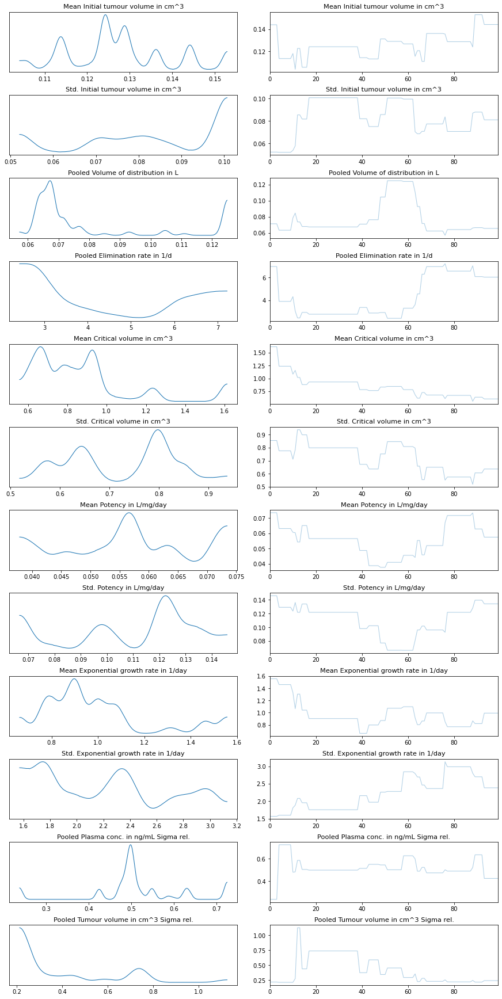

/Users/david/Documents/SABS/DPhil/erlotinib/venv/lib/python3.7/site-packages/arviz/plots/traceplot.py:201: UserWarning:

rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (44), generating only 20 plots



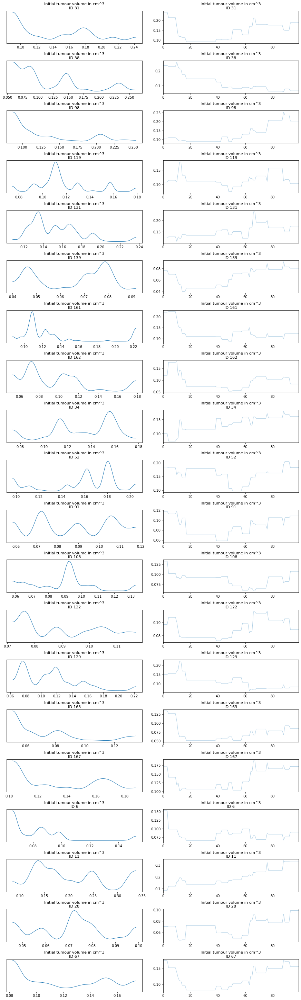

/Users/david/Documents/SABS/DPhil/erlotinib/venv/lib/python3.7/site-packages/arviz/plots/traceplot.py:201: UserWarning:

rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (44), generating only 20 plots



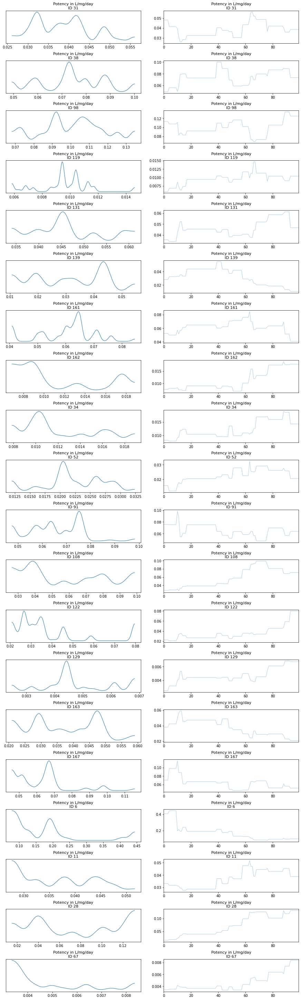

In [19]:
az.plot_trace(
    posterior_samples, 
    var_names=[
        'Mean Initial tumour volume in cm^3',
        'Std. Initial tumour volume in cm^3',
        'Pooled Volume of distribution in L',
        'Pooled Elimination rate in 1/d',
        'Mean Critical volume in cm^3',
        'Std. Critical volume in cm^3',
        'Mean Potency in L/mg/day',
        'Std. Potency in L/mg/day',
        'Mean Exponential growth rate in 1/day',
        'Std. Exponential growth rate in 1/day',
        'Pooled Plasma conc. in ng/mL Sigma rel.',
        'Pooled Tumour volume in cm^3 Sigma rel.'])
plt.show()

az.plot_trace(
    posterior_samples, 
    var_names=[
        'Initial tumour volume in cm^3',
        'Critical volume in cm^3'],
    compact=False)
plt.show()

az.plot_trace(
    posterior_samples, 
    var_names=[
        'Potency in L/mg/day',
        'Exponential growth rate in 1/day'],
    compact=False)
plt.show()

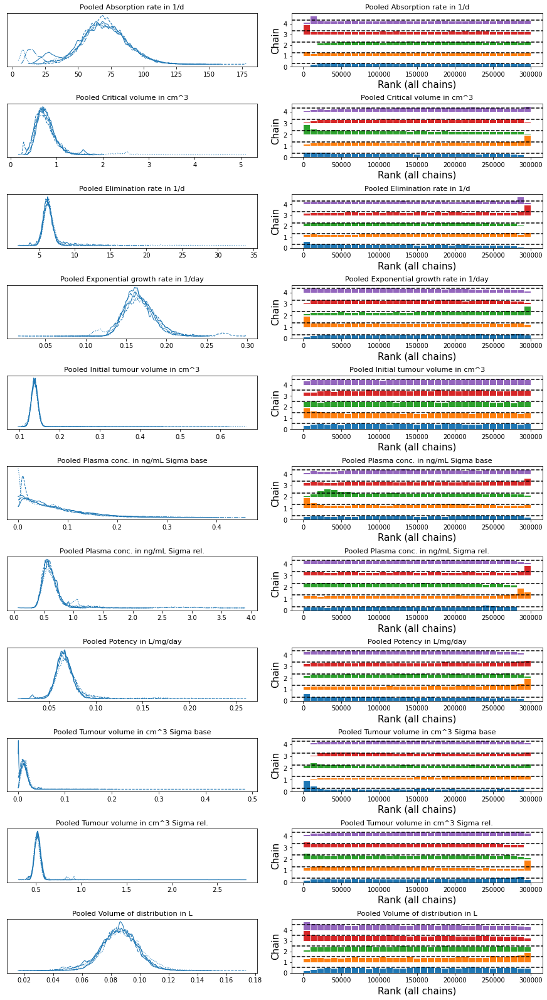

In [12]:
az.plot_trace(posterior_samples, kind='rank_bars')
plt.show()

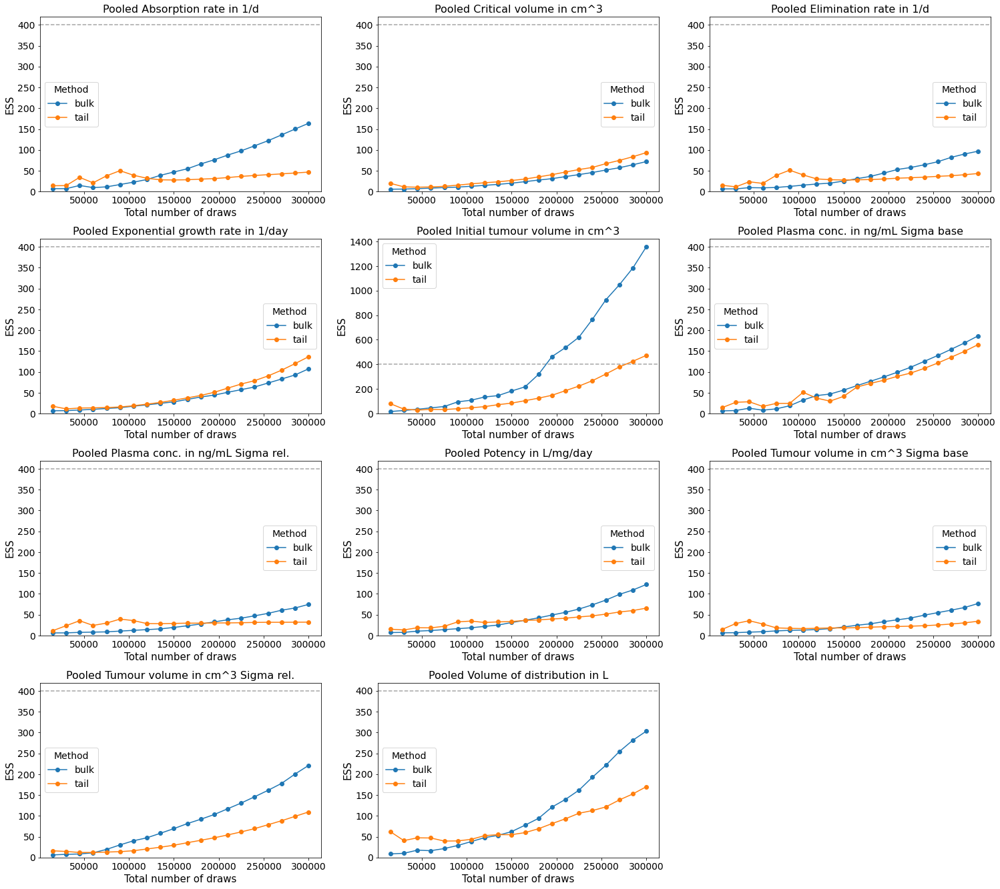

In [13]:
az.plot_ess(posterior_samples, kind="evolution")
plt.show()

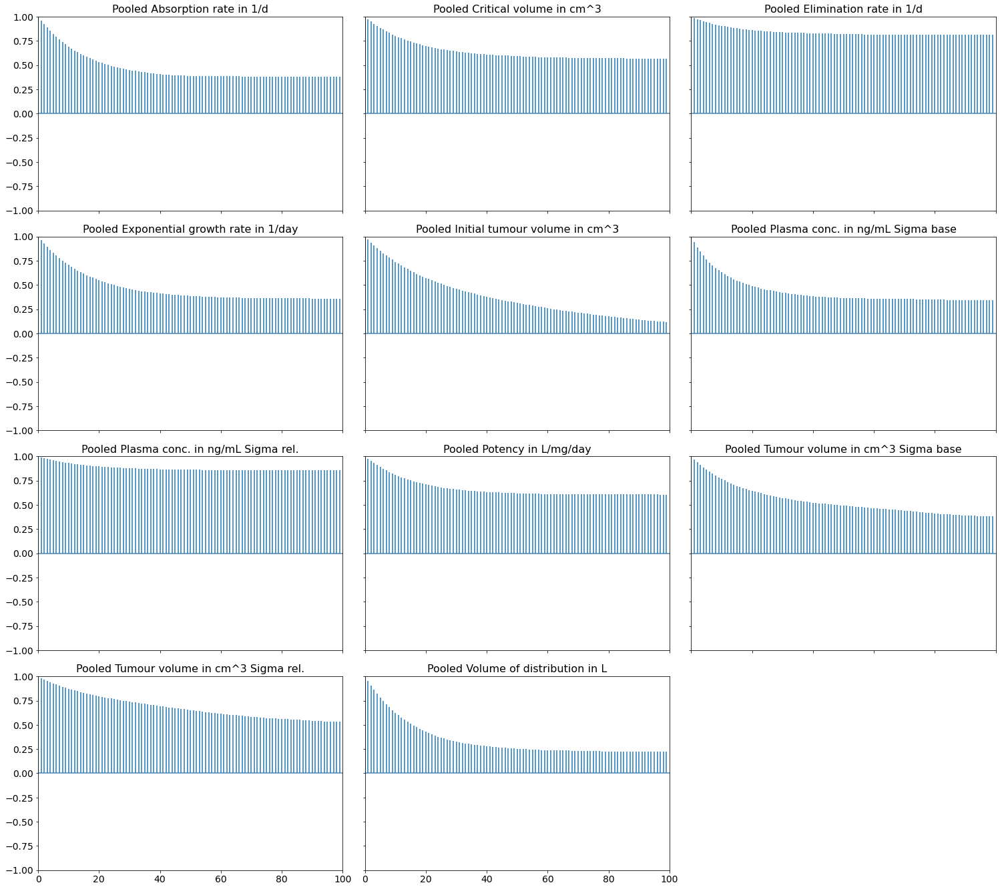

In [14]:
az.plot_autocorr(posterior_samples, combined=True)
plt.show()

### Exclude warmup

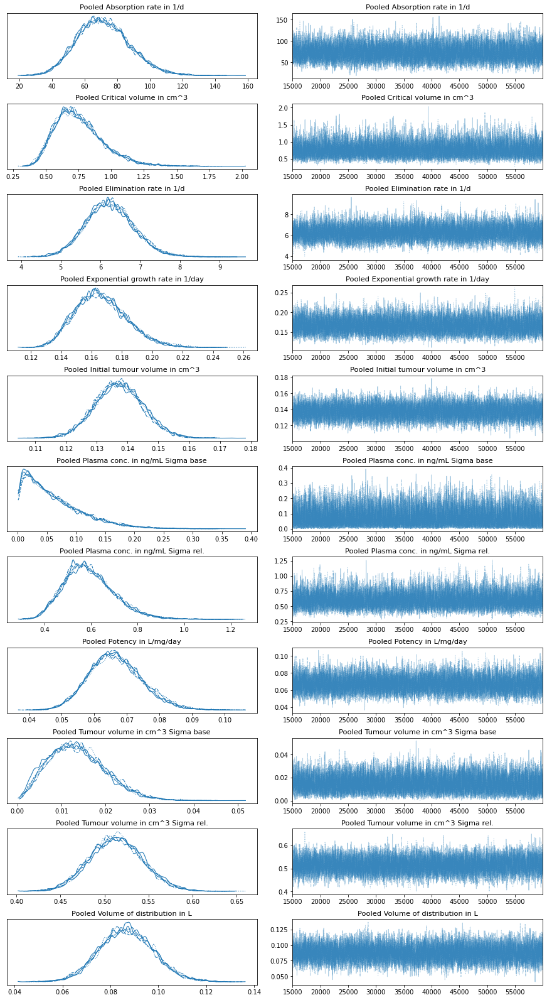

In [15]:
warmup = 15000

az.plot_trace(posterior_samples.sel(draw=slice(warmup, n_iterations)))
plt.show()

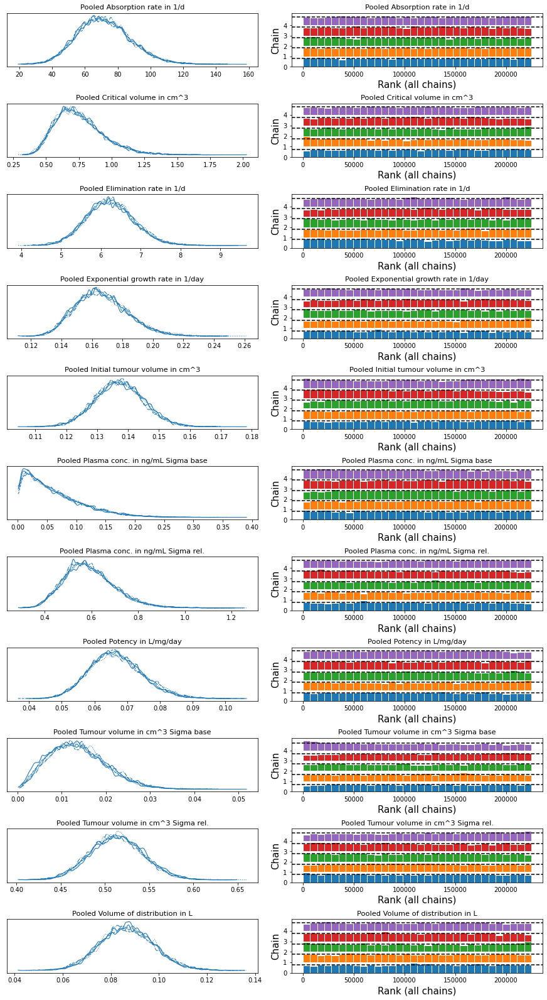

In [16]:
az.plot_trace(posterior_samples.sel(draw=slice(warmup, n_iterations)), kind='rank_bars')
plt.show()

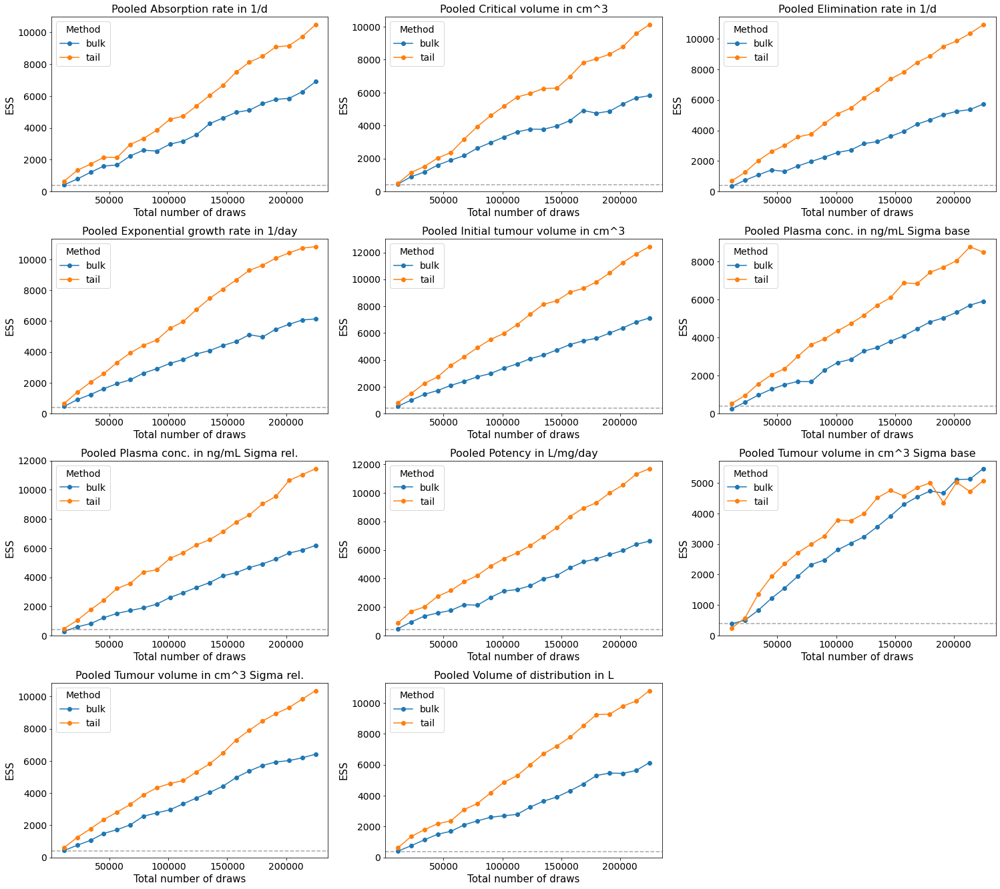

In [17]:
az.plot_ess(posterior_samples.sel(draw=slice(warmup, n_iterations)), kind="evolution")
plt.show()

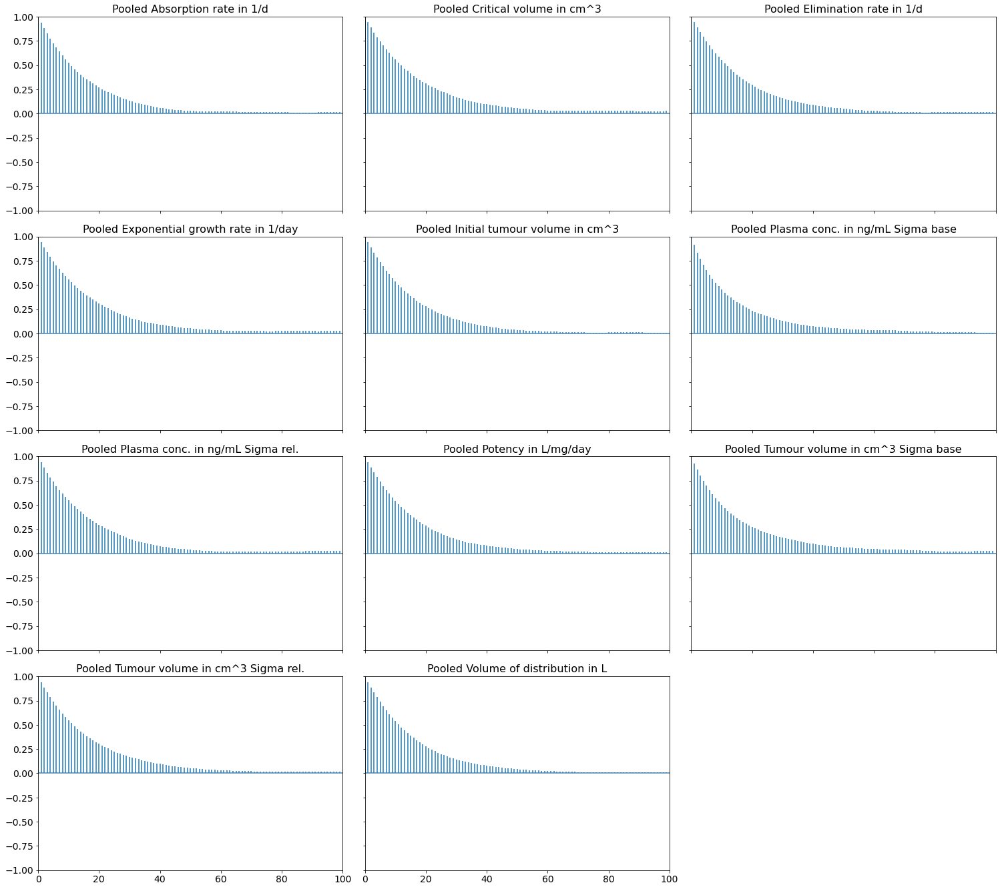

In [18]:
az.plot_autocorr(posterior_samples.sel(draw=slice(warmup, n_iterations)), combined=True)
plt.show()

### Reduce correlations by thinning out

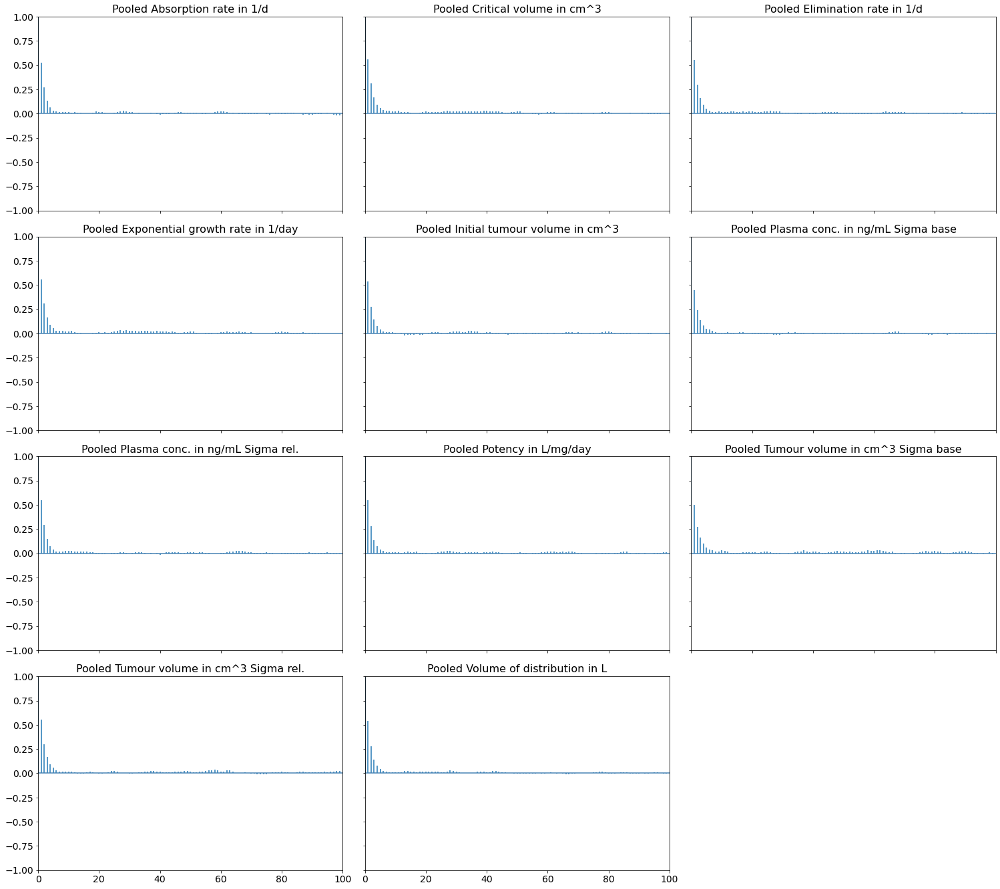

In [19]:
thinning_ratio = 10

az.plot_autocorr(posterior_samples.sel(draw=slice(warmup, n_iterations, thinning_ratio)), combined=True)
plt.show()

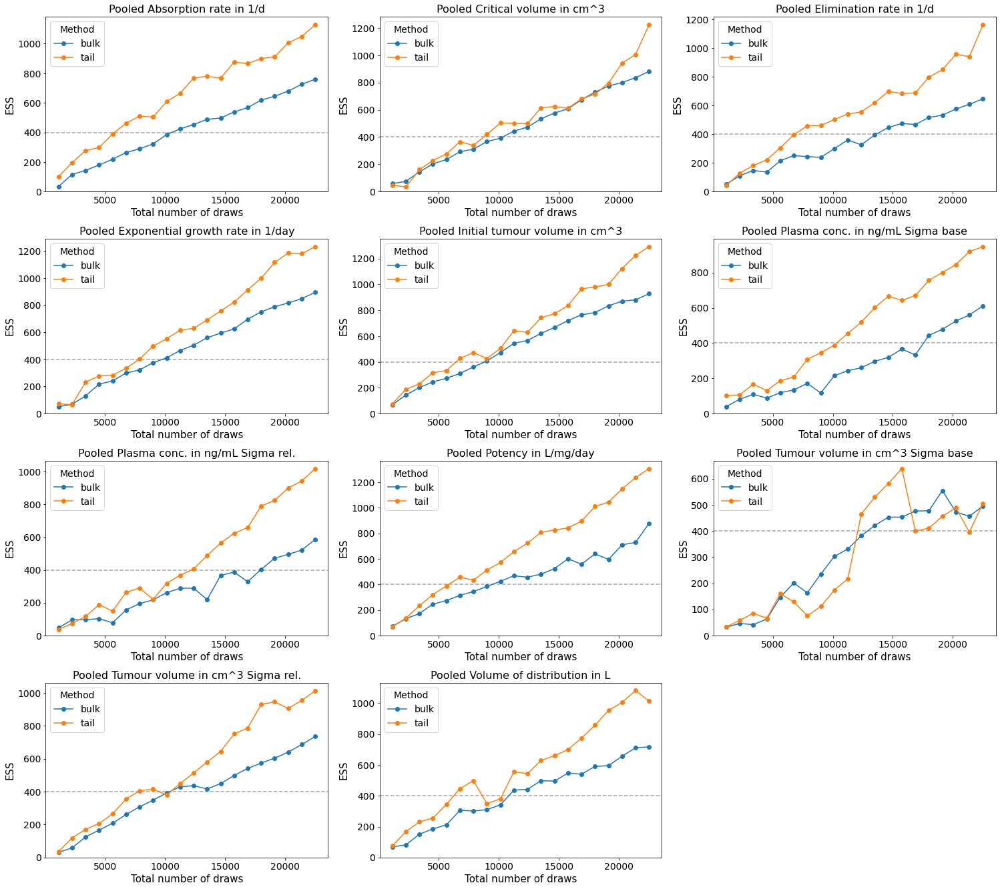

In [20]:
az.plot_ess(posterior_samples.sel(draw=slice(warmup, n_iterations, thinning_ratio)), kind="evolution")
plt.show()

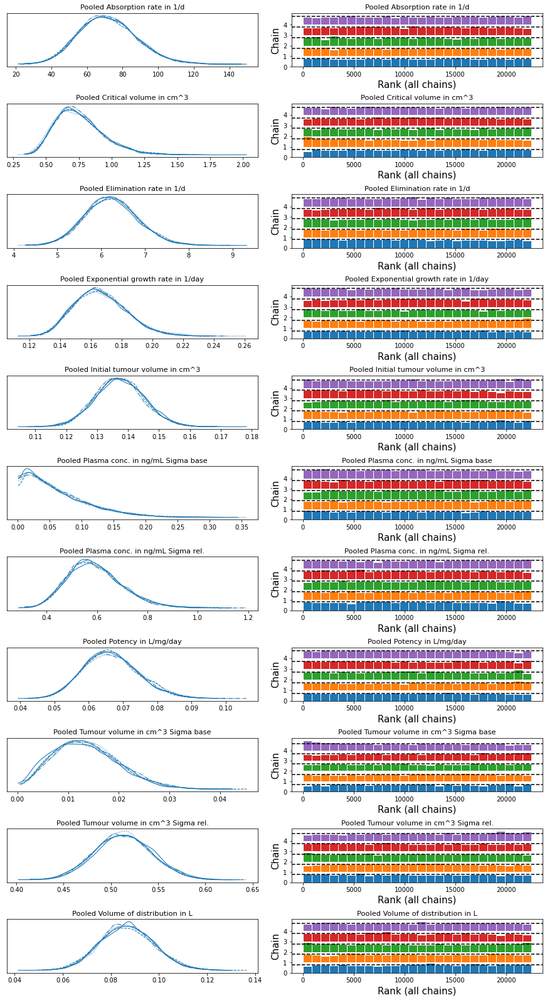

In [21]:
az.plot_trace(posterior_samples.sel(draw=slice(warmup, n_iterations, thinning_ratio)), kind='rank_bars')
plt.show()

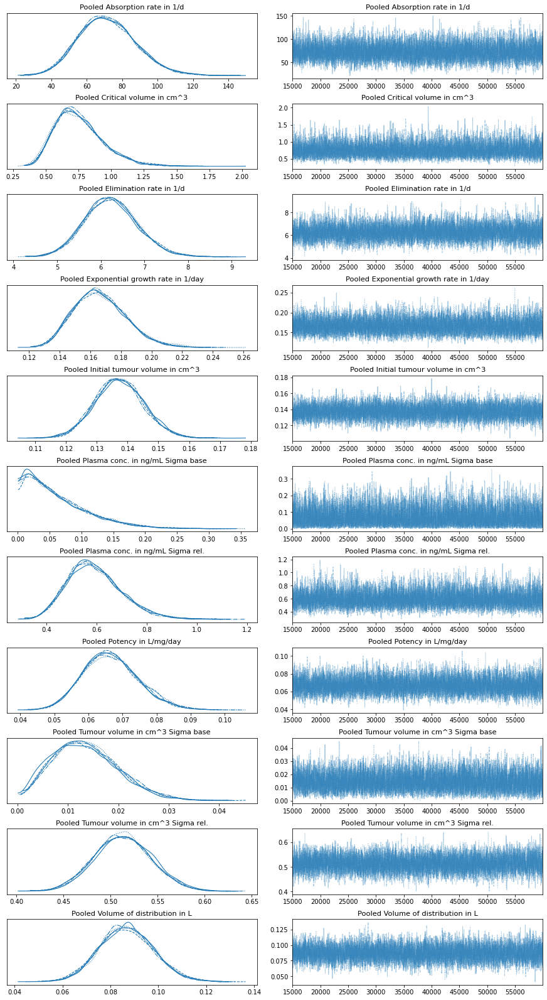

In [22]:
az.plot_trace(posterior_samples.sel(draw=slice(warmup, n_iterations, thinning_ratio)))
plt.show()

## Save posterior

In [23]:
import os

# Rename parameters (for export)
temp = posterior_samples.rename({
    'Pooled Initial tumour volume in cm^3': 'pooled_initial_tumour_volume',
    'Pooled Critical volume in cm^3': 'pooled_critical_volume',
    'Pooled Exponential growth rate in 1/day': 'pooled_growth_rate',
    'Pooled Plasma conc. in ng/mL Sigma base': 'pooled_plasma_concentration_sigma_base',
    'Pooled Plasma conc. in ng/mL Sigma rel.': 'pooled_plasma_concentration_sigma_rel',
    'Pooled Absorption rate in 1/d': 'pooled_absorption_rate',
    'Pooled Volume of distribution in L': 'pooled_volume_distribution',
    'Pooled Elimination rate in 1/d': 'pooled_elimination_rate',
    'Pooled Potency in L/mg/day': 'pooled_potency',
    'Pooled Tumour volume in cm^3 Sigma base': 'pooled_tumour_volume_sigma_base',
    'Pooled Tumour volume in cm^3 Sigma rel.': 'pooled_tumour_volume_sigma_rel'})

# Export samples
directory = os.getcwd()
name = '/posteriors/pooled.nc'
temp.sel(draw=slice(warmup, n_iterations, thinning_ratio)).to_netcdf(directory + name)